In [1]:
import warnings
warnings.filterwarnings("ignore")

In [2]:
import numpy as np
import pandas as pd
import seaborn as sns
import igraph as ig
import matplotlib.pyplot as plt
from datetime import datetime
from scipy.sparse import csr_matrix, isspmatrix

import scanpy as sc
import scanpy.external as sce

sc.settings.verbosity = 3
sc.settings.set_figure_params(dpi=80)
time_start = datetime.now()

In [3]:
import sys
sys.path.append('../..')

from src.configs import config
from src.utils import utils as us
from src.utils import visualise as vs
%load_ext autoreload
%autoreload 2
# warnings.filterwarnings("once")

# Data Load

In [4]:
adata = sc.read(config.PATHS.LOGS/'Norm.h5ad')
print('isspmatrix:', isspmatrix(adata.X))


print('Loaded Filtered AnnData object: number of cells', adata.n_obs)
print('Loaded Filtered AnnData object: number of genes', adata.n_vars) 
print('Available metadata for each cell: ', adata.obs.columns)

isspmatrix: True
Loaded Filtered AnnData object: number of cells 34314
Loaded Filtered AnnData object: number of genes 14783
Available metadata for each cell:  Index(['timepoint', 'line', 'cluster', 'timepoint_mapped', 'batch', 'dataset',
       'isHuman', 'isESC', 'n_genes_by_counts', 'total_counts',
       'total_counts_mito', 'pct_counts_mito', 'total_counts_ribo',
       'pct_counts_ribo', 'QC_doublets', 'n_genes', 'n_counts'],
      dtype='object')


# Check for batch effects

In [5]:
adata.obs['cluster_ematb'] = adata.obs.cluster.apply(
    lambda x: x if 'C' == x[0] else 'N')
adata_check = adata.copy()

sc.pp.pca(
    adata_check, n_comps=50, use_highly_variable=True,
    svd_solver='arpack')
sc.pp.neighbors(adata_check, n_neighbors=30, n_pcs=25)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:06)
computing neighbors
    using 'X_pca' with n_pcs = 25
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:31)


computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:19)


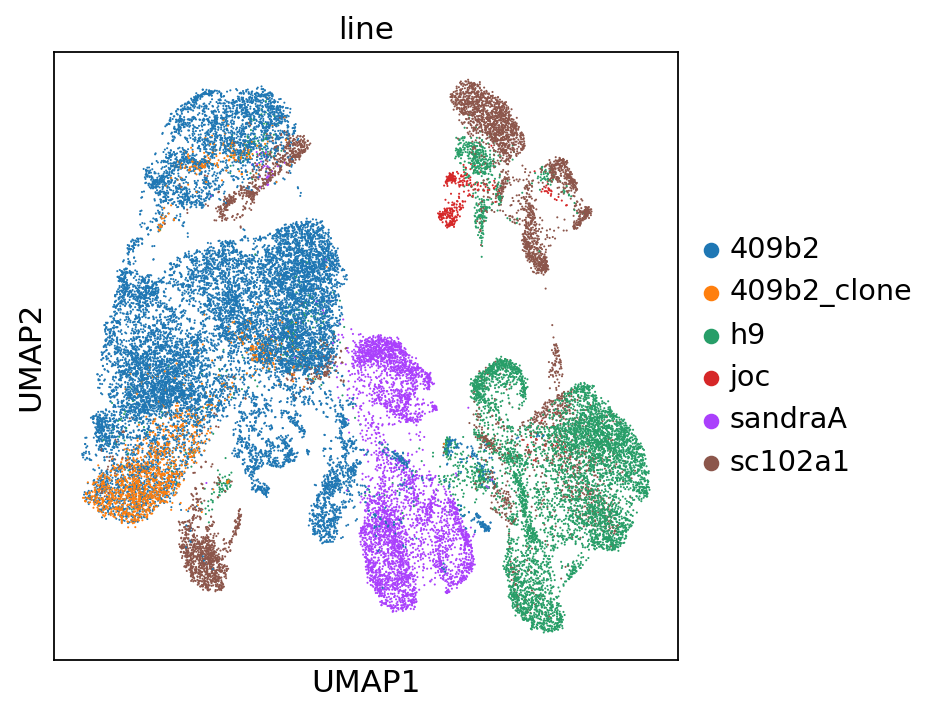

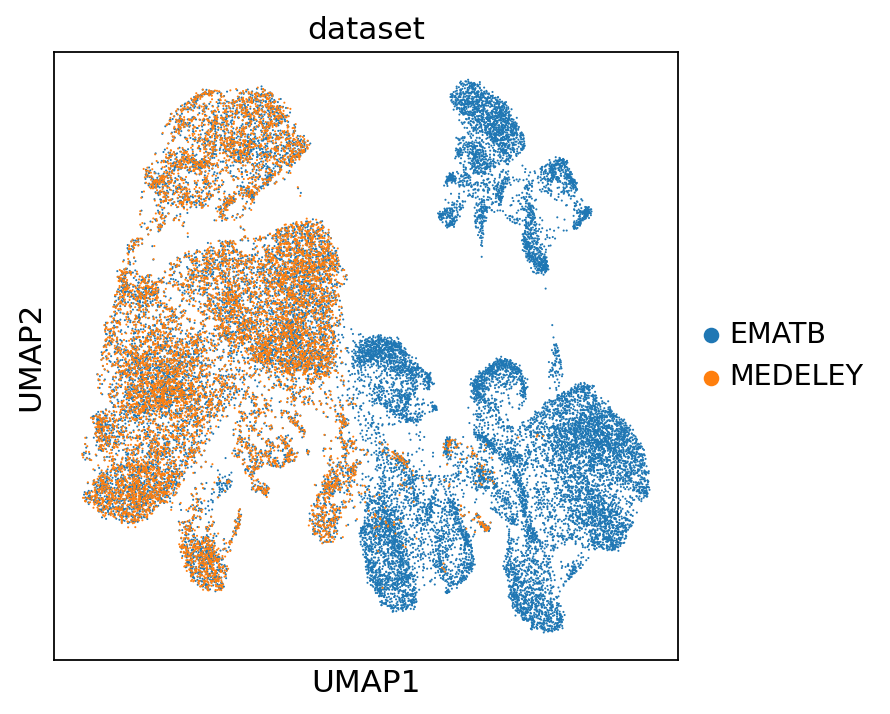

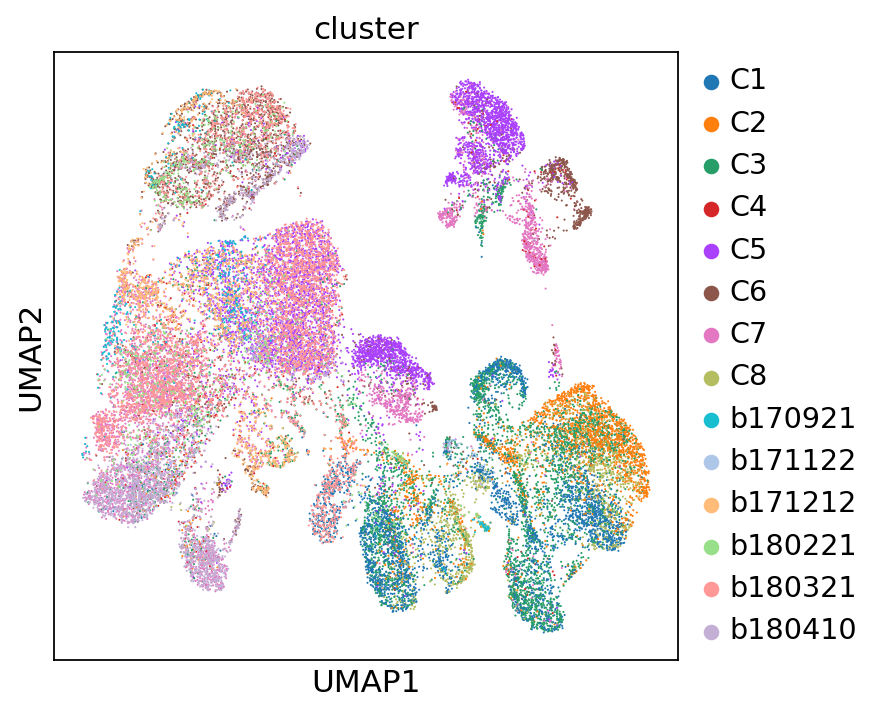

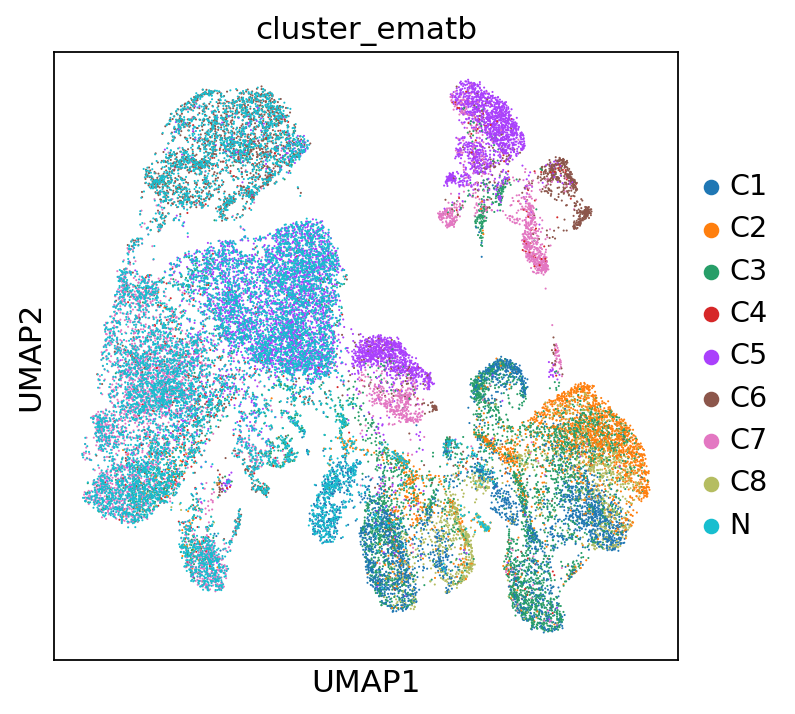

In [6]:
sc.tl.umap(adata_check)
for key in ['line', 'dataset', 'cluster', 'cluster_ematb']:
    fig, ax = plt.subplots(1, 1, figsize=(5, 5))
    sc.pl.umap(adata_check, color=key, alpha=1., ax=ax)
    fig.savefig(config.PATHS.APPENDIX/'umap_{}_wbatch'.format(key))
    # us.log('', 'umap_{}_wbatch'.format(key))
    plt.show()

In [7]:
del adata_check

# Integration with Harmony

computing PCA
    on highly variable genes
    with n_comps=21
    finished (0:00:03)


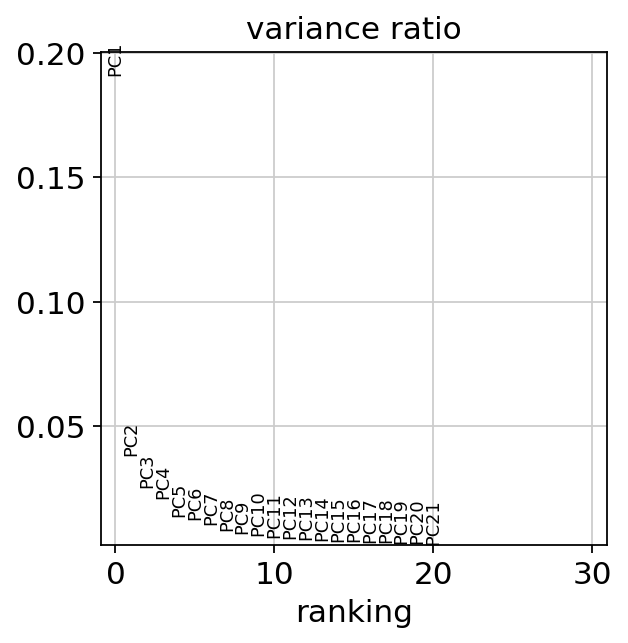

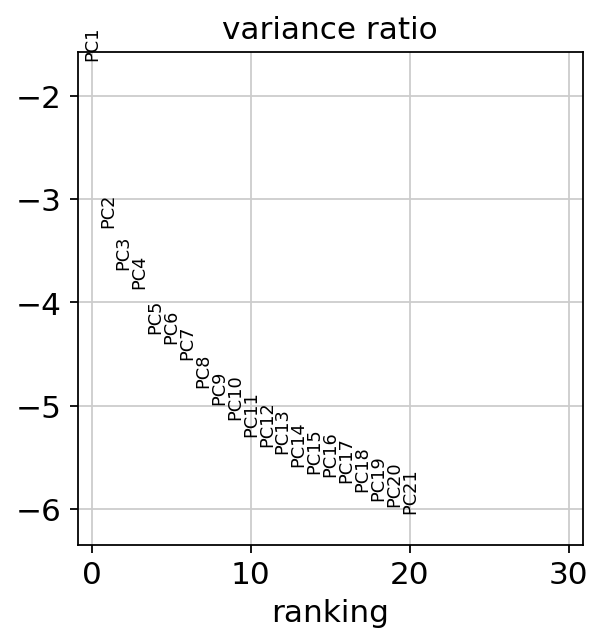

In [8]:
sc.pp.pca(
    adata, n_comps=21, use_highly_variable=True, svd_solver='arpack')
sc.pl.pca_variance_ratio(adata)
sc.pl.pca_variance_ratio(adata, log=True)

## Performing correction with Harmony

Harmony uses an iterative clustering approach to align cells from different batches. For each iteration:

    soft k-means clustering to group cells from multiple datasets
    computation for each cluster of a global centroid and a dataset-specific centroid
    from the centroids, calculation of a correction factor
    the correction factor is used to correct each cell with a cell-specific factor


In [9]:
sc.external.pp.harmony_integrate(adata, 'line')

2023-10-20 09:59:25,982 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2023-10-20 09:59:30,766 - harmonypy - INFO - sklearn.KMeans initialization complete.
2023-10-20 09:59:30,932 - harmonypy - INFO - Iteration 1 of 10
2023-10-20 09:59:44,169 - harmonypy - INFO - Iteration 2 of 10
2023-10-20 10:00:00,717 - harmonypy - INFO - Iteration 3 of 10
2023-10-20 10:00:14,975 - harmonypy - INFO - Iteration 4 of 10
2023-10-20 10:00:28,377 - harmonypy - INFO - Iteration 5 of 10
2023-10-20 10:00:40,909 - harmonypy - INFO - Converged after 5 iterations


## Repeat plot with batch-corrected PCA

New corrected PC are saved in .obs["X_pca_harmony"]

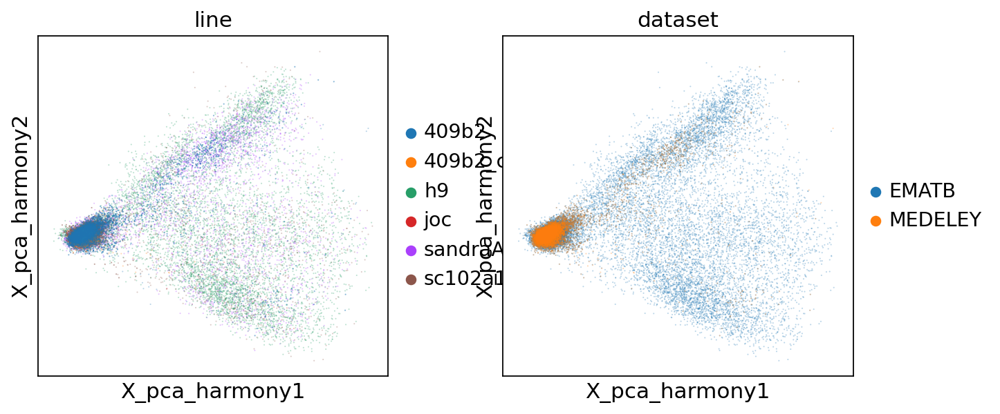

In [10]:
sc.pl.embedding(
    adata, basis="X_pca_harmony", color=['line', 'dataset'], alpha=.3)

# Calculate dimensionality reductions

In [11]:
sc.pp.neighbors(
    adata, n_neighbors=120, 
    n_pcs=19, use_rep="X_pca_harmony", 
    key_added="harmony", metric='cosine')
#sc.pp.neighbors(adata, n_neighbors=80, n_pcs=15, use_rep="X_pca_harmony", key_added="harmony", )

computing neighbors
    finished: added to `.uns['harmony']`
    `.obsp['harmony_distances']`, distances for each pair of neighbors
    `.obsp['harmony_connectivities']`, weighted adjacency matrix (0:00:44)


computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:24)


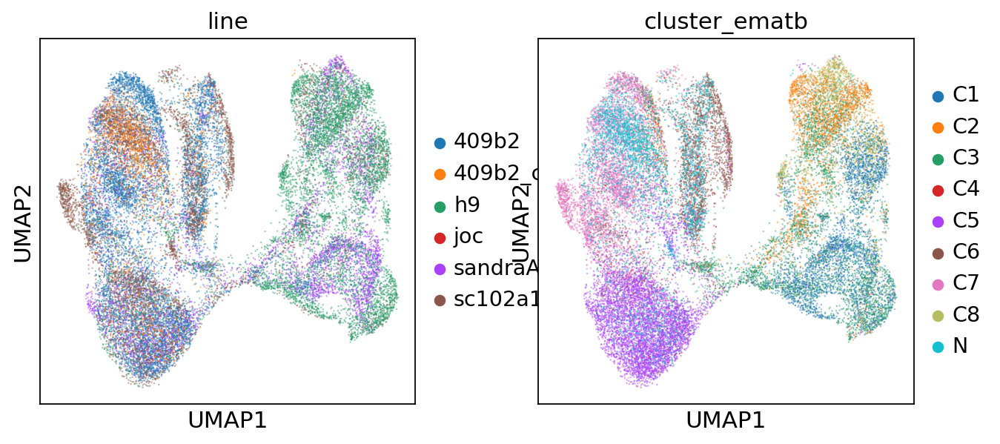

In [12]:
sc.tl.umap(adata, neighbors_key="harmony", random_state=config.PROTO.SEED)
sc.pl.umap(adata, color=['line', 'cluster_ematb'], alpha=.5)

In [ ]:
sc.tl.umap(adata, neighbors_key="harmony", random_state=config.PROTO.SEED)
sc.pl.umap(adata, color=['line', 'cluster'], alpha=.5)

computing UMAP


In [ ]:
# Calculate the Diffusion Map
sc.tl.diffmap(adata, neighbors_key="harmony")

In [ ]:
# Calculate the Force-directed graph

#Takes quite some time 
sc.tl.draw_graph(adata, neighbors_key="harmony")

# Visualize UMAP

In [ ]:
sc.pl.umap(
    adata, color=[
        'n_genes_by_counts',"total_counts", 
        'pct_counts_mito', 'pct_counts_ribo'])

In [ ]:
sc.settings.set_figure_params(dpi=120)
sc.pl.umap(adata, color=['line', 'cluster_ematb'])

# Visualize Diffusion Map

In [ ]:
sc.settings.set_figure_params(dpi=80)
sc.pl.diffmap(adata, color=['n_genes_by_counts',"total_counts", 'pct_counts_mito', 'pct_counts_ribo'], 
             components=['2,3'])

In [ ]:
sc.settings.set_figure_params(dpi=120)
sc.pl.diffmap(adata, color=['line', 'cluster_ematb'], components=['1,2'])

# Visualize Force-directed graph

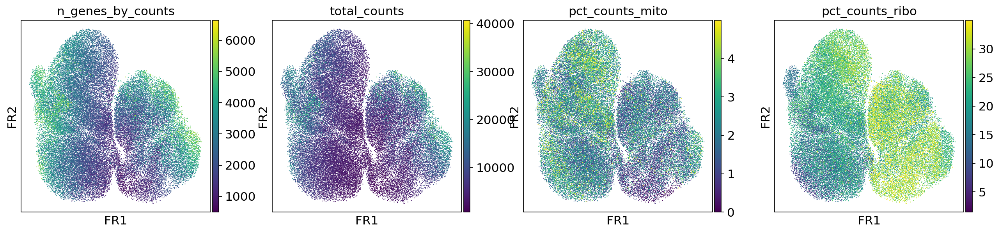

In [20]:
sc.settings.set_figure_params(dpi=80)
sc.pl.draw_graph(adata, color=[
    'n_genes_by_counts',"total_counts", 'pct_counts_mito', 
    'pct_counts_ribo'])

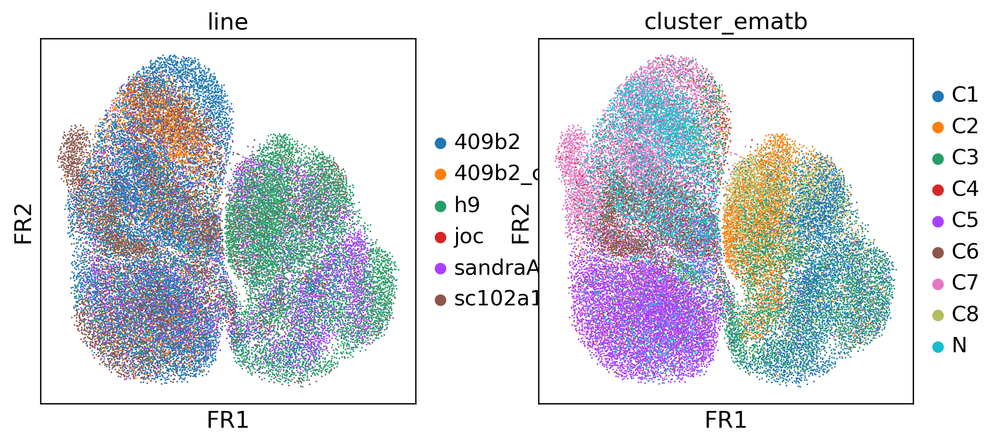

In [21]:
sc.settings.set_figure_params(dpi=120)
sc.pl.draw_graph(adata, color=['line', 'cluster_ematb'])

# Cell population markers
Functions for plotting markers in UMAP

In [ ]:
def selectMarkers(adataObj, mList):
    """  From a list of gene names select only the genes that are present in adata.var
    """
    #Select markers present in adata
    p = adataObj.var_names[adataObj.var_names.isin(mList) == True]
    #Keep the same order as input list
    p = [x for x in mList if x in p]   
    
    #Select missing genes
    ab = set(mList).difference(set(adataObj.var_names))
    
    #Print message
    if len(ab) == len(mList):
        print('\nAll markers are missing')
    else:
        print('\nThe following marker genes are missing: ', ab)
        
    return(p)

def CustomUmap(adata, genes):
    genes = selectMarkers(adata, genes)
    sc.pl.umap(adata, color=genes, size=10, frameon=False,
               vmin='p1',  vmax='p99', layer='lognormcounts')


The following marker genes are missing:  set()


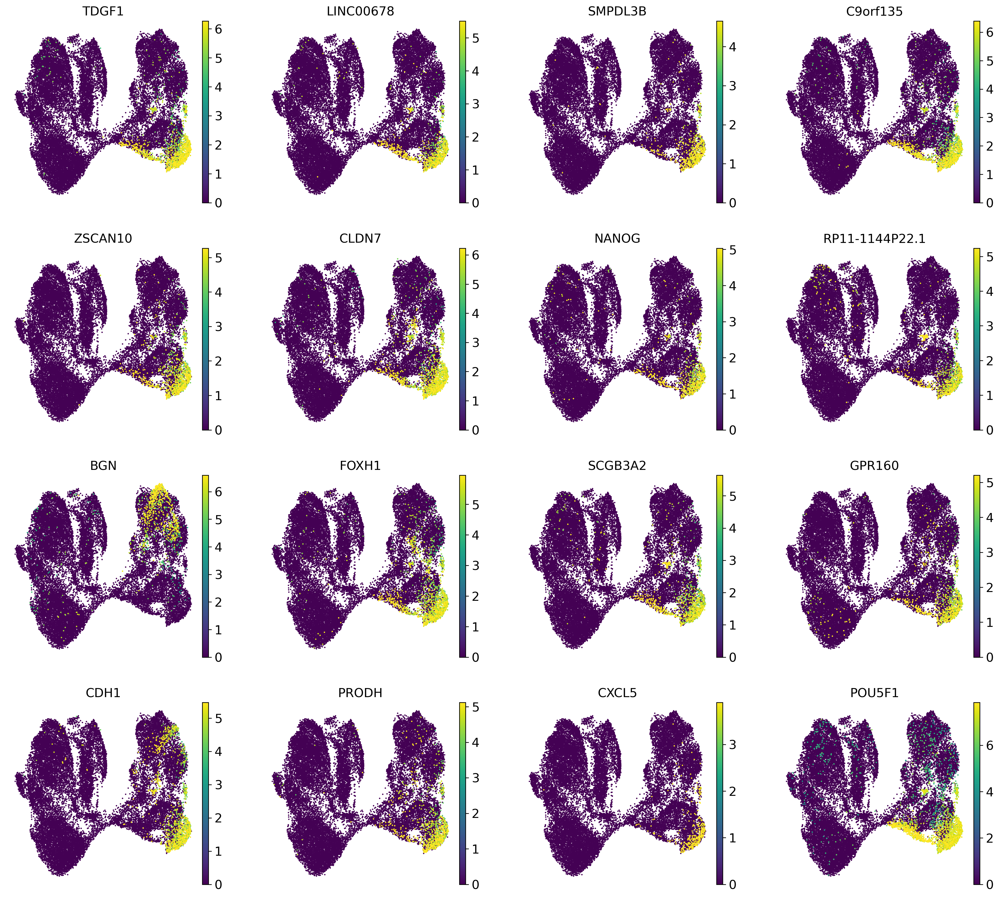

In [25]:
# Top Triku genes

TopTriku = adata.var.sort_values(by=['triku_distance'], ascending=False).head(16).index
CustomUmap(adata, TopTriku)

In [26]:
# Dictionary of marker genes

marker_dictionary = {
    'Proliferation': ['MKI67', 'CDC20', 'HMGB2', 'CCNB1'], 
    'Apical Progenitors': ['FABP7', 'GLI3', 'PAX6', 'NES', 'SOX1', 'SOX2', 'SOX9', 'VIM'], 
    'Intermediate Progenitors': ['EOMES', 'ELAVL4', 'NHLH1', 'KCNQ3'], 
    'Pan-neuronal': ['DCX', 'STMN2', 'SYT1', 'SYP', 'GAP43', 'MEF2C',  'FOXG1'], 
    'ExcitatoryNeurons': ['EMX1', 'NEUROD1', 'NEUROD2', 'NEUROD6', 'NEUROG2', 'SLC17A7', 'TBR1', 'BCL11A', 'CUX1', 'CUX2', 'SATB2'], 
    'Inhibitory Neurons': ['DLX5', 'DLX6', 'DLX6-AS1', 'GAD1', 'GAD2', 'NKX2.1', 'SST', 'NPY', 'CALB1', 'CALB2', 'VIP', 'PVALB'], 
    'oRG': ['FAM107A', 'HOPX',  'PTPRZ1', 'TNC'], 
    'Astrocytes': ['GFAP', 'SLC1A3',  'S100B', 'AQP4', 'FGFR3', 'ALDH1L1']
    
    }



 Proliferation

The following marker genes are missing:  set()


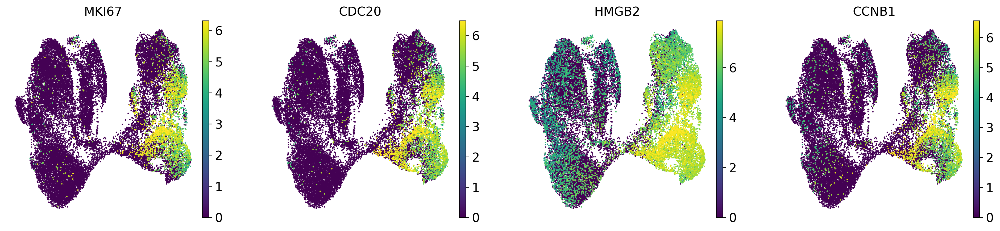



 Apical Progenitors

The following marker genes are missing:  set()


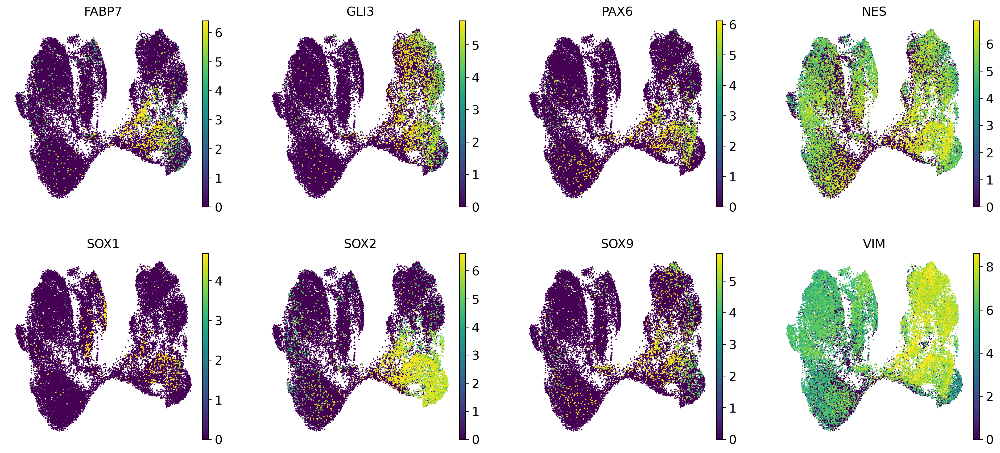



 Intermediate Progenitors

The following marker genes are missing:  {'EOMES'}


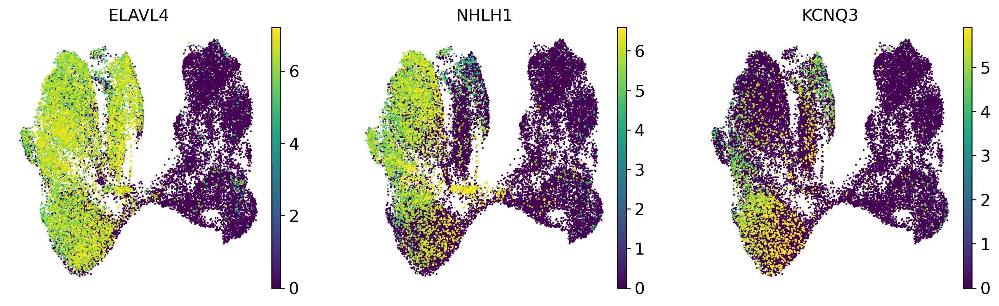



 Pan-neuronal

The following marker genes are missing:  {'FOXG1'}


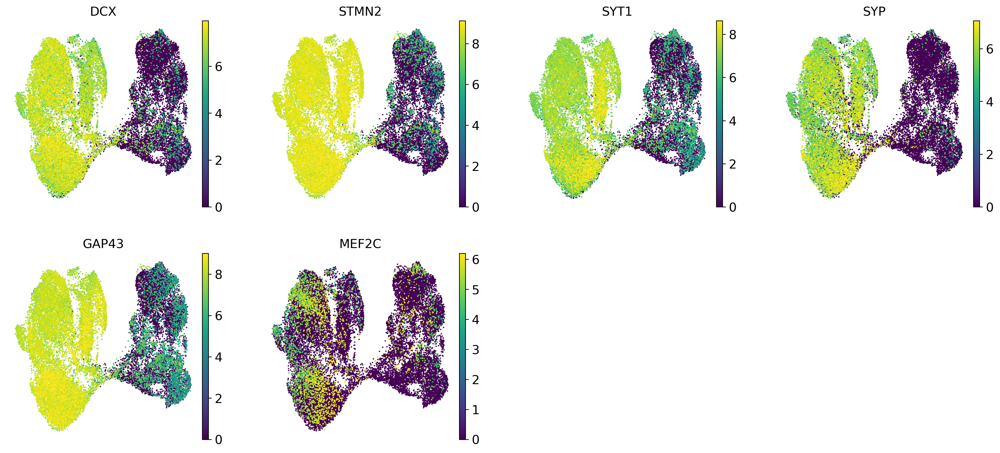



 ExcitatoryNeurons

The following marker genes are missing:  {'TBR1', 'EMX1', 'NEUROD6'}


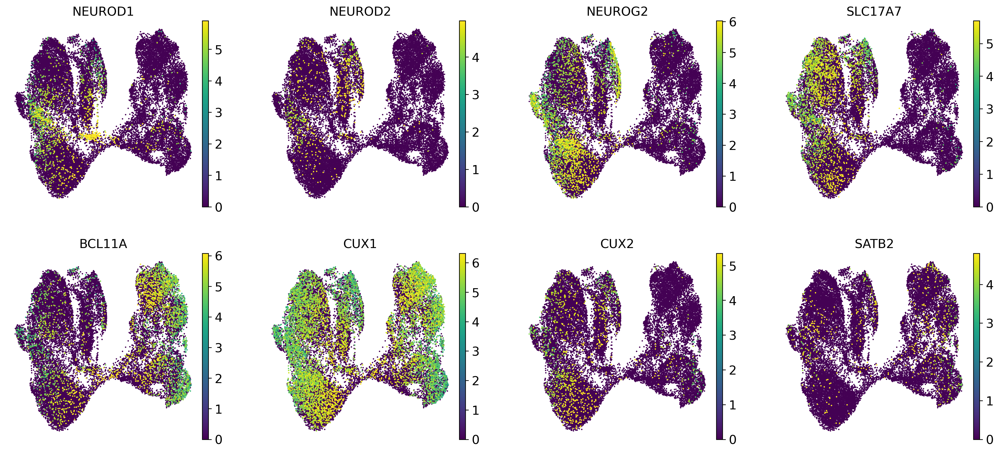



 Inhibitory Neurons

The following marker genes are missing:  {'VIP', 'DLX6', 'DLX6-AS1', 'NKX2.1', 'DLX5'}


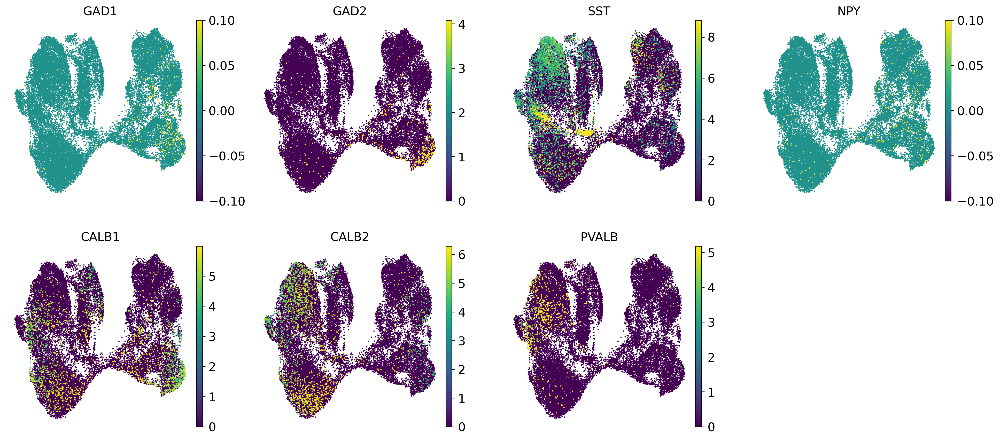



 oRG

The following marker genes are missing:  {'FAM107A'}


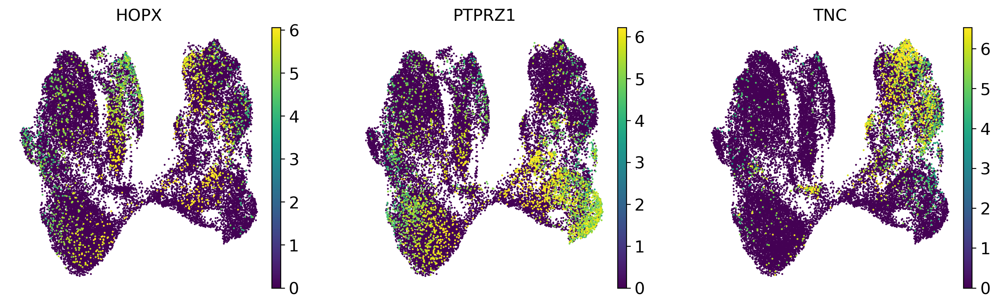



 Astrocytes

The following marker genes are missing:  {'AQP4', 'GFAP', 'ALDH1L1'}


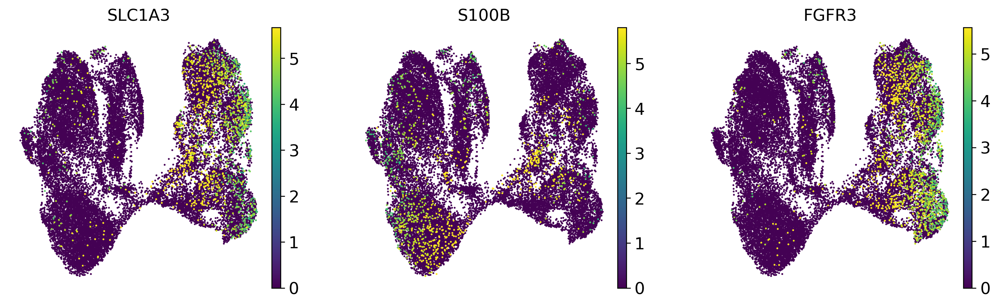

In [27]:
# Marker gene plotting

for Pop in marker_dictionary: 
    print("\n\n {}".format(Pop)) 
    CustomUmap(adata, marker_dictionary[Pop])

# Save

In [ ]:
adata.write(config.PATHS.LOGS/'Reduced.h5ad')
print(datetime.now() - time_start)